# <a href="https://miptstats.gitlhub.io/courses/ad_fivt.html">Введение в анализ данных</a>
## Домашнее задание 7. Кластеризация и понижение размерности

**Правила, <font color="red">прочитайте внимательно</font>:**

* Выполненную работу нужно отправить телеграм-боту `@miptstats_ds24_bot`. Для начала работы с ботом каждый раз отправляйте `/start`. **Работы, присланные иным способом, не принимаются.**
* Дедлайн см. в боте. После дедлайна работы не принимаются кроме случаев наличия уважительной причины.
* Прислать нужно **ноутбук в формате `ipynb`**.
* Следите за размером файлов. **Бот не может принимать файлы весом более 20 Мб.** Если файл получается больше, заранее разделите его на несколько.
* Выполнять задание необходимо полностью самостоятельно. **При обнаружении списывания все участники списывания будут сдавать устный зачет.**
* Решения, размещенные на каких-либо интернет-ресурсах, не принимаются. Кроме того, публикация решения в открытом доступе может быть приравнена к предоставлении возможности списать.
* Для выполнения задания используйте этот ноутбук в качестве основы, ничего не удаляя из него. Можно добавлять необходимое количество ячеек.
* Комментарии к решению пишите в markdown-ячейках.
* Выполнение задания (ход решения, выводы и пр.) должно быть осуществлено на русском языке.
* Если код будет не понятен проверяющему, оценка может быть снижена.
* Никакой код из данного задания при проверке запускаться не будет. *Если код студента не выполнен, недописан и т.д., то он не оценивается.*

**Правила оформления теоретических задач:**

* Решения необходимо прислать одним из следующих способов:
  * фотографиями в правильной ориентации, где все четко видно, а почерк разборчив,
    * отправив их как файл (`pdf`/`png`/`jpg`) боту вместе с ноутбуком
    * *или* вставив ее в ноутбук посредством `Edit -> Insert Image` при редактировании markdown-ячейки (<font color="red">фото, вставленные ссылкой, не принимаются</font>);
  * в виде $\LaTeX$ в markdown-ячейках.
* Решения не проверяются, если какое-то требование не выполнено. Особенно внимательно все проверьте в случае выбора второго пункта (вставки фото в ноутбук). **<font color="red">Неправильно вставленные фотографии могут не передаться при отправке.</font>** Для проверки попробуйте переместить `ipynb` в другую папку и открыть его там.
* **В решениях поясняйте, чем вы пользуетесь**, хотя бы кратко. Например, если пользуетесь независимостью, то достаточно подписи вида "*X и Y незав.*"
* Решение, в котором есть только ответ, и отсутствуют вычисления, оценивается в 0 баллов.



**Баллы за задание:**

* Задача 1 &mdash; 30 баллов
* Задача 2 &mdash; 30 баллов
* Задача 3 &mdash; 120 баллов

Баллы учитываются в <b><font color="green">факультативной части</font></b> курса и не влияют на оценку по основной части.

In [1]:
# Bot check

# HW_ID: fpmi_ad7
# Бот проверит этот ID и предупредит, если случайно сдать что-то не то.

# Status: not final
# Перед отправкой в финальном решении удали "not" в строчке выше.
# Так бот проверит, что ты отправляешь финальную версию, а не промежуточную.
# Никакие значения в этой ячейке не влияют на факт сдачи работы.

In [2]:
import plotly.io as pio
pio.renderers.default = 'iframe'

In [2]:
!pip install dash

In [3]:
import io
import os
import base64

import numpy as np
import pandas as pd
from tqdm.cli import tqdm

import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import plotly.express as px
import plotly
from dash import Dash, dcc, html, Input, Output, no_update, callback

from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import torch
from transformers import ViTImageProcessor, ViTModel

sns.set_theme(style="darkgrid", palette="Set2")

In [4]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

<font size="4"><b>Внимание! Файл с решением может быть тяжелым. Если он весит 20 Мб и более, заранее разделите его на несколько частей.</b></font>

---
### Задача 1.

Докажите, что метод KMeans делит все пространство объектов на выпуклые многоугольники, возможно, неограниченные.

![task1](img1.jpg)

---
### Задача 2.

Как мы знаем из <a href="https://miptstats.github.io/courses/ad_fivt/lecture8.pdf">лекции</a>, в пространствах большой размерности расстояния между случайными объектами становятся неинформативными. Эта проблема известна как *проклятие размерности*, и она влечет соответствующие ограничения на использование методов, основанных на использовании расстоянии между объектами.

В этой задаче предлагается промоделировать ситуацию понижения размерности. Сгенерируйте достаточно большое количество точек в единичном кубе в пространстве некоторой размерности. Пример кода дан ниже

In [5]:
sample_size = 1000
dimensions = np.array([15, 100, 200, 500, 600, 700, 850, 1000]);

def CalculateNorm(vector):
    """
        vector - numpy.array (n,) or (m, n) n - dimensionality
    """
    if len(vector.shape) == 1:
        return np.array([np.sqrt(np.sum(vector ** 2))])
    else:
        return np.sqrt(np.sum(vector ** 2, axis=1))

def Normalize(data):
    """
      data - numpy.array (n, )
    """
    return data / np.mean(data);

def GenerateAndNormalizeSamples(dimension, sample_size):
    samples = np.random.uniform(size=(sample_size, dimension))
    norms = CalculateNorm(samples);
    return Normalize(norms);


Повторите генерацию для нескольких размерностей пространства от 2 до 1000. Используйте не менее 7 различных значений размерностей пространства.

In [6]:
print(GenerateAndNormalizeSamples(100, 20))

[0.98045967 0.97365354 0.99238637 1.02487966 0.99855619 0.97738145
 1.06107596 1.00899897 1.01259755 0.98186839 0.99347752 0.97278043
 0.91995873 0.99713549 1.00410834 1.06042442 1.04675721 1.00273945
 0.99039739 1.00036324]


Для каждой размерности посчитайте норму каждой точки, тем самым получая набор значений расстояния от 0 до случайной точки. Нормируйте все расстояния, поделив на среднее полученных расстояний для каждой размерности пространства.

Нарисуйте на одном графике <a href="https://miptstats.github.io/courses/python/09_seaborn.html#3.-Оценки-плотности" target="_blank">KDE-оценки плотности</a> нормированных расстояний для каждой размерности пространства.

In [7]:
def BuildKDEPlot(dimensions, data = None):
  """
    dimensions - numpy.array (p,)
    what dimensionality of points to be generated/displayed

    data - numpy.array (m, n)
    m - features(m_1 + m_2 + ...)
  """

  with sns.axes_style('darkgrid'):
    fig, axes = plt.subplots(1, 1, figsize=(12,10));
    i = 0;
    for dim in dimensions:
      if(data is not None):
        to_display = CalculateNorm(data[i:i+dim].reshape(data.shape[1], dim));
        to_display = Normalize(to_display);
      else:
        to_display = GenerateAndNormalizeSamples(dim, sample_size);
      sns.kdeplot(data=to_display, label=f"d={dim}")

      i += dim;
    axes.legend(loc="upper right")

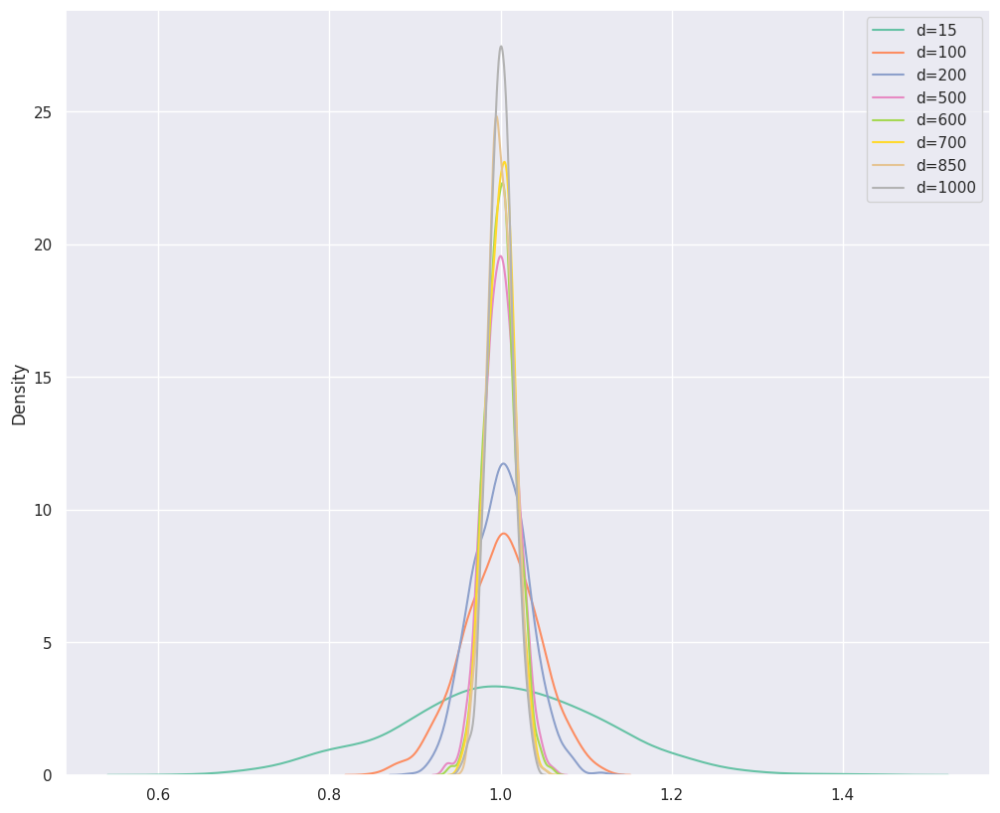

In [8]:
BuildKDEPlot(dimensions)

Сделайте выводы

Видно, что с ростом размерности, евклидова метрика теряет свою информативность, все точки начинают "походить" друг на друга, т.е быть близкими

---
### Задача 3.

В этой задаче мы попробуем кластеризовать различными способами изображения котиков из датасета с <a href="https://miptstats.github.io/courses/ad_fivt/pca.html" target="_blank">семинара</a>.

Скачайте данные, загрузите их и отрисуйте несколько примеров.

In [9]:
from google.colab import drive
drive.mount('/content/drive')

!cp /content/drive/MyDrive/cats.zip /

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [10]:
!unzip /cats.zip

Archive:  /cats.zip
replace cats/9727.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

(15747, 12288)


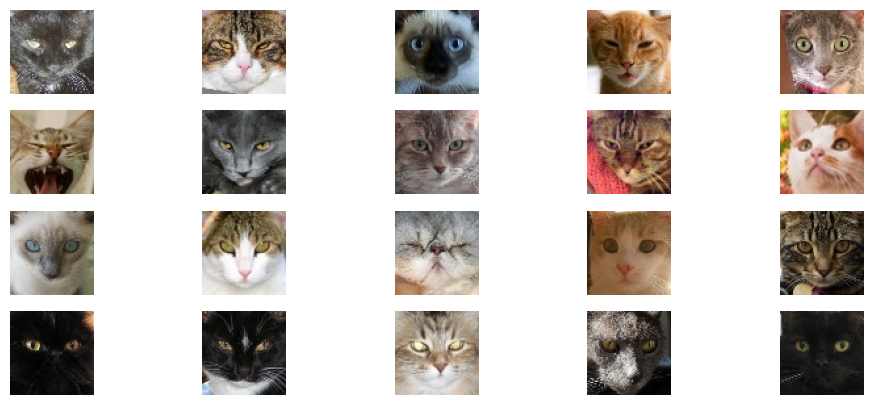

In [11]:
# Загружаем картинки
# <...>


cats_path = "/content/cats"
cats = []

for filename in os.listdir(cats_path):
    cats.append(plt.imread(os.path.join(cats_path, filename)))

cats = np.stack(cats).reshape(-1, 64*64*3);
print(cats.shape)

# Визуализируем примеры
plt.figure(figsize=(12, 5))
for i in range(20):
    plt.subplot(4, 5, i + 1)
    plt.imshow(cats[i].reshape(64, 64, 3))
    plt.axis("off")

#### 1. Свойства метрики в пространстве котиков

Прежде всего давайте исследуем, наблюдается ли проблема проклятия размерности в пространстве котиков, фактически повторив исследование предыдущей задачи. Для этого выберите не менее 10000 случайных пар изображений и посчитайте расстояния между ними. Визуализируйте <a href="https://miptstats.github.io/courses/python/09_seaborn.html#3.-Оценки-плотности" target="_blank">KDE-оценку плотности</a> нормированных расстояний.

Повторите те же действия к результату применения PCA, рассмотрев разное количество компонент, например, для 30, 100 и 500. Обратите внимание, что PCA нужно обучать на всех изображениях, а не только для тех, для которых вы будете считать расстояния. Примеры обучения PCA можно посмотреть в <a href="https://miptstats.github.io/courses/ad_fivt/pca.html" target="_blank">ноутбуке</a> с занятия.

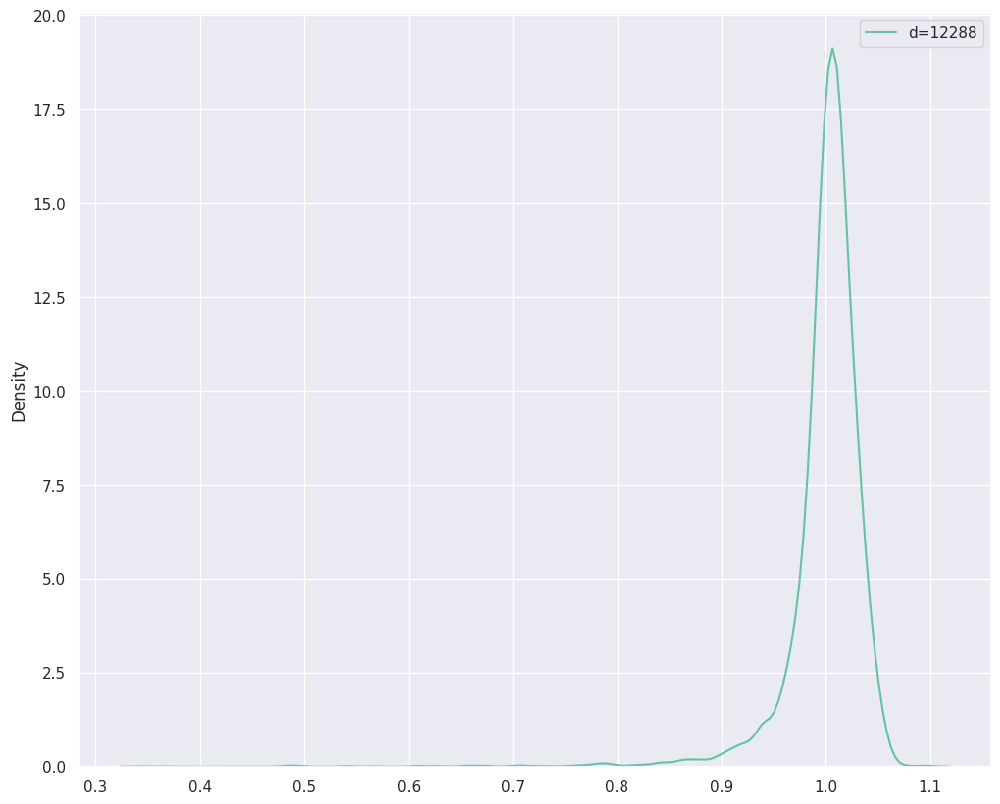

In [12]:
np.random.shuffle(cats);

SIZE_OF_SUBARR = 10000;

BuildKDEPlot([12288], cats[:SIZE_OF_SUBARR].reshape(cats.shape[1], SIZE_OF_SUBARR))

In [13]:

number_of_components = np.array([30, 50, 100, 200]);


np.random.shuffle(cats);

new_cats = [];

for comp in number_of_components:
  pca = PCA(n_components=comp);
  pca.fit(cats);
  reduced_cats = np.array(pca.transform(cats[:SIZE_OF_SUBARR]));
  reduced_cats = reduced_cats.reshape(-1, reduced_cats.shape[0]);
  print(reduced_cats.shape)
  new_cats.append(reduced_cats)

new_cats = np.vstack(new_cats);
print(new_cats.shape)

(30, 10000)
(50, 10000)
(100, 10000)
(200, 10000)
(380, 10000)


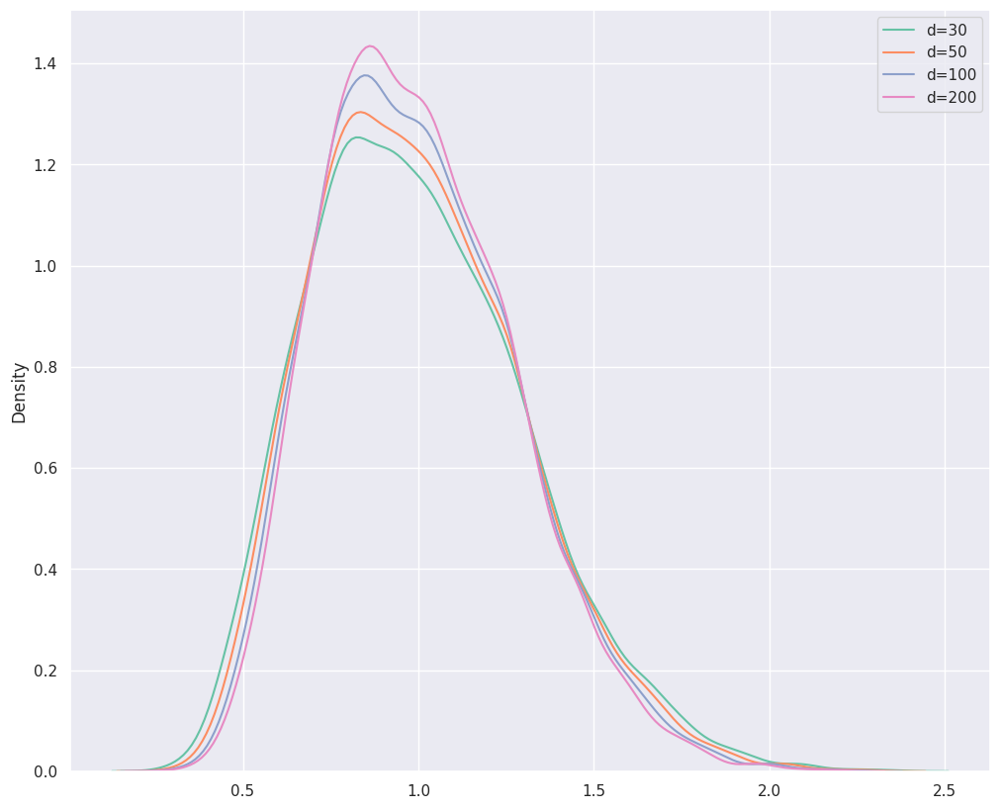

In [14]:
BuildKDEPlot(number_of_components, new_cats)

Сделайте выводы

Со второго графика видно, что PCA сохранило максимальную дисперсию по всем primary components, рост каждого холмика незначителен, т.к приблизительно всю дисперсию привносят первые 50 компонент.

На первом же графике видно, что датасет котиков тоже страдает от проклятие размерности, но не так сильно как сгенерированные выше 10000 точек.

#### 2. Кластеризация котиков по вектору изображения

Начнем эксперименты с самого простого способа: каждое изображение можно вытянуть в вектор размерности $64 \cdot 64 \cdot 3$, их и попытаемся кластеризовать. Обучите по этим объектам метод KMeans, пример можно посмотреть в <a href="https://miptstats.github.io/courses/ad_fivt/clustering.html" target="_blank">ноутбуке</a> по кластеризации

In [15]:
#%%time

def CalculateVar(labeled_points, points, cluster_centers):
  variances = np.zeros((cluster_centers.shape[0]));
  for i in range(cluster_centers.shape[0]):
    cur_cluster = [];
    for j in range(labeled_points.shape[0]):
      if labeled_points[j] == i:
        cur_cluster.append(points[j]);

    cur_cluster = np.array(cur_cluster, dtype=np.float64);
    #print(cur_cluster[0])
    cur_cluster -= cluster_centers[i]; #vector from cluster center to its member
    #print(cur_cluster[0])
    #print("Center:")
    #print(cluster_centers[i])

    norms = CalculateNorm(np.array(cur_cluster))
    #print(norms.shape)
    mean = np.mean(norms);
    variance = 0;
    for point in cur_cluster:
      norm = CalculateNorm(point);
      variance += (norm - mean) ** 2;

    variances[i] = variance / cur_cluster.shape[0];
  return variances;


In [16]:
number_of_clusters = [2, 3, 4, 5, 6, 10]

def BuildElbowChart(number_of_clusters, variances):
  """
    variances np.array (n,)
    number_of_clusters np.array (n,)
  """
  diffs = [];

  prev_var = variances[0];
  for var in variances:
    diffs.append(prev_var - var);
    prev_var = var;
  print(diffs)
  with sns.axes_style('darkgrid'):
    sns.lineplot(x=number_of_clusters, y=diffs)

In [17]:
variances = [];
predicted_classes = []
cluster_centers = []

def TestKmeans(data, number_of_clusters, predicted_classes, cluster_centers, variances):
  for cn in number_of_clusters:
    kmeans = KMeans(n_clusters=cn, random_state=33, init="k-means++", n_init="auto");
    kmeans.fit_transform(data)

    predicted_classes.append(kmeans.labels_);
    cluster_centers.append(kmeans.cluster_centers_);
    cluster_variances = CalculateVar(kmeans.labels_, data, kmeans.cluster_centers_);

    variances.append(np.sum(cluster_variances));

In [18]:
TestKmeans(cats, number_of_clusters, predicted_classes, cluster_centers, variances)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  variances[i] = variance / cur_cluster.shape[0];
<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  variances[i] = variance / cur_cluster.shape[0];
<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  variances[i] = variance / cur_cluster.shape[0];
<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning: Conversion of an array 

[0.0, -1486735.196632862, -770003.5252108593, -806784.9495209884, -1573829.008755208, -3791467.173031643]


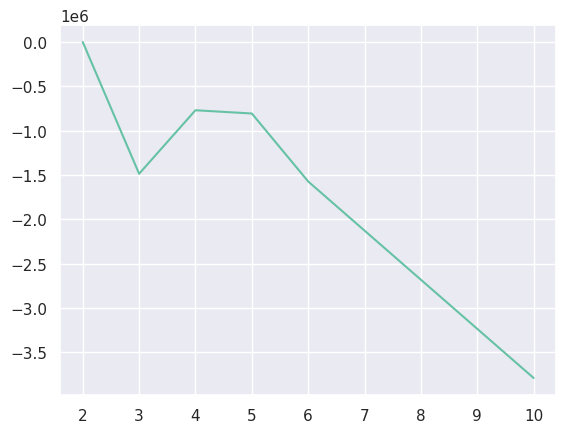

In [19]:
variances = np.array(variances);

BuildElbowChart(number_of_clusters, variances)

Теперь отобразим изображения на плоскость с помощью PCA и визуализируем полученные предсказания цветом, как это было сделано на семинаре для ответов на вопросы в бот. Ниже уже реализована функция отрисовки `visualize_images_clusterisation`, вам требуется лишь применить PCA и вызвать функцию с правильными параметрами.

In [20]:
pca = PCA(n_components=2);
projection = pca.fit_transform(cats);

In [21]:
def visualize_images_clusterisation(images, projection, clusters, port=None, use_dash=False):
    '''
    Визуализиует двумерную проекцию эмбеддингов изображений,
    во всплывающем окне показывает сами изображения

    :param images: набор изображений
    :param projection: двумерная проекция изображений или эмбеддингов изображений
    :param clusters: предсказанные кластера
    :param port: опциональный параметр, порт на котором поднимается визуализация:
                 одинаковые порты - одинаковые графики, но если в ноутбуке открыто много портов, то могут начаться лаги
    :param use_dash: если True, то рисуются картинки, но не сохраняется интерактивный график,
                     если False, то наоборот график в ноутбуке сохранится, но картинок не будет
    '''
    plotly.offline.init_notebook_mode()

    # Рисуем график с точками как на семинаре
    fig = px.scatter(
        x=projection[:, 0], y=projection[:, 1],
        hover_name=clusters,
        hover_data={'image_idx': list(range(len(images)))},
        color=clusters.astype(str),
        width=1000, height=800,
        title='PCA проекция изображений на плоскость',
        size=[1] * len(images),
        size_max=12,
    )

    if not use_dash:
        fig.show()
        return

    # Добавляем во всплывающее окошко (hover box) изображения
    fig.update_traces(
        hoverinfo="none",
        hovertemplate=None,
    )

    app = Dash(__name__)

    app.layout = html.Div(
        className="container",
        children=[
            dcc.Graph(id="graph-2-dcc", figure=fig, clear_on_unhover=True),
            dcc.Tooltip(id="graph-tooltip-2", direction='bottom'),
        ],
    )

    @callback(
        Output("graph-tooltip-2", "show"),
        Output("graph-tooltip-2", "bbox"),
        Output("graph-tooltip-2", "children"),
        Output("graph-tooltip-2", "direction"),

        Input("graph-2-dcc", "hoverData"),
    )
    def display_hover(hoverData):
        '''
        Настраивает всплывающее окно hover box.

        :param hoverData: данные соответствующей точки
        '''
        if hoverData is None:
            return False, no_update, no_update, no_update

        # Достаем индекс картинки, который выше положили в hover_data
        hover_data = hoverData["points"][0]
        image_idx = hover_data['customdata'][0]
        # И получаем само изображение кота
        image = Image.fromarray(images[image_idx].reshape(64, 64, 3))

        # Преобразовываем изображение в base64 кодировку
        buffer = io.BytesIO()
        image.save(buffer, format="jpeg")
        encoded_image = base64.b64encode(buffer.getvalue()).decode()
        image_url = "data:image/jpeg;base64, " + encoded_image

        image_children = [
            html.Img(
                src=image_url,
                style={"width": "196px"},
            ),
        ]

        return True, hover_data["bbox"], image_children, 'top'

    if port is None:
        port = str(np.random.randint(5000, 15000))
    app.run(port=port, debug=True, jupyter_height=800)

    return app

In [22]:
configure_plotly_browser_state()
visualize_images_clusterisation(cats, projection, predicted_classes[2], False)

Для каждого кластера нарисуйте по 5-10 типичных изображений, то есть ближайших к центру кластера. Похожую операцию мы видели на занятии в <a href="https://miptstats.github.io/courses/ad_fivt/clustering.html" target="_blank">ноутбуке</a> по кластеризации.

*Примечание.* Для одного кластера рисуйте картинки "в строчку". Так будет удобно как вам самим, так и проверяющему. Примеры можно посмотреть в <a href="https://miptstats.github.io/courses/ad_fivt/pca.html" target="_blank">ноутбуке</a> по PCA.

In [23]:
NUMBER_OF_CLOSEST = 10;

def DrawTypical(data, images, predicted_classes, cluster_centers, number_of_closest):
  closest = [];

  i = 0;
  for center in cluster_centers:
    cur_cluster = []
    for j in range(predicted_classes.shape[0]):
      if predicted_classes[j] == i:
        cur_cluster.append(j);

    distances = np.linalg.norm(center - data[cur_cluster], axis=1)
    # Сортируем расстояния и берем индексы в порядке возрастания расстояний
    closest_idxs = np.argsort(distances)

    closest.append(closest_idxs[:number_of_closest])
    i += 1;

  i = 0;

  fig, axes = plt.subplots(cluster_centers.shape[0], number_of_closest, figsize=(10, 10))

  for arr in closest:
    for elem in arr:
      row = i // number_of_closest
      col = i % number_of_closest

      axes[row, col].imshow(images[elem].reshape(64, 64, 3))
      axes[row, col].axis('off')
      i += 1;

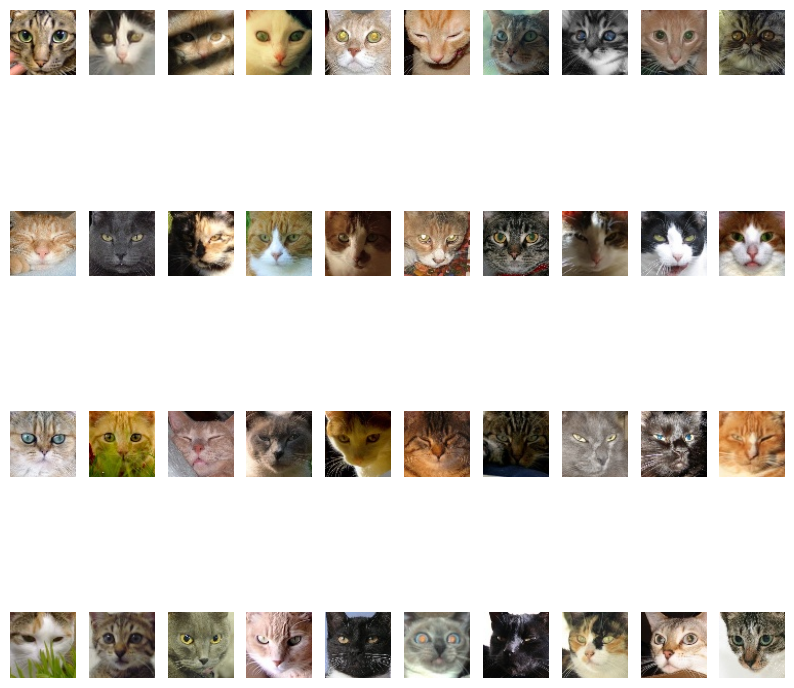

In [24]:
DrawTypical(cats, cats, predicted_classes[2], cluster_centers[2], 10);

Наблюдаются ли какие-то закономерности в изображениях внутри одного кластера? Если да, то опишите отличительные черты кластеров.

***Ответ:***
Если смотреть на ближайшие к центру точки, то практически никакой закономерности не видно.
Здесь напрямую видно проблему евклидовой метрики на больших размерностях.
Но если понаводить на точки на графике из разных кластеров видно, что первый кластер это более светлые котики, второй - котики с белым пятнышком на мордочке, третий - более тёмные котики.

Подумайте, чем может быть плох такой подход? Какая проблема могла возникнуть и возникла ли? Обратите внимание на проведенное ранее исследование.

***Ответ:*** Главная проблема это евклидова метрика и её неустойчивость к росту размерности пространства

#### 3. PCA + кластеризация

Попробуем уменьшить размерность перед кластеризацией с помощью PCA, спроектировав изображения на первые несколько главных компонент

**Примечание.** Не стоит брать больше 100 главных компонент

Сделайте кластеризацию:

In [25]:
#%%time

pca = PCA(n_components=5);
pca.fit(cats);

reduced_cats = np.array(pca.transform(cats));

pca = PCA(n_components=2);
projection = pca.fit_transform(reduced_cats);

number_of_clusters = [2, 3, 4, 5, 6, 10]
variances = []
predicted_classes = []
cluster_centers = []

TestKmeans(reduced_cats, number_of_clusters, predicted_classes, cluster_centers, variances)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this o

[0.0, -1169422.8341313088, -530027.6786464257, -345537.1434935285, -1220964.1873104554, -2363033.4365525804]


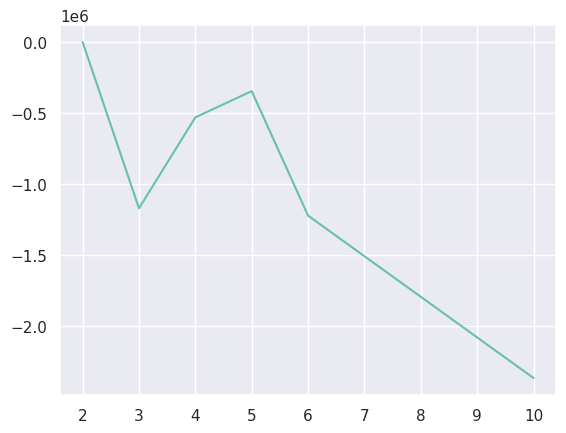

In [26]:
variances = np.array(variances);

BuildElbowChart(number_of_clusters, variances)

Визуализируйте полученные кластера:

In [27]:
configure_plotly_browser_state()
visualize_images_clusterisation(cats, projection, predicted_classes[2], False)

Нарисуйте по 5-10 типичных изображений для новых кластеров

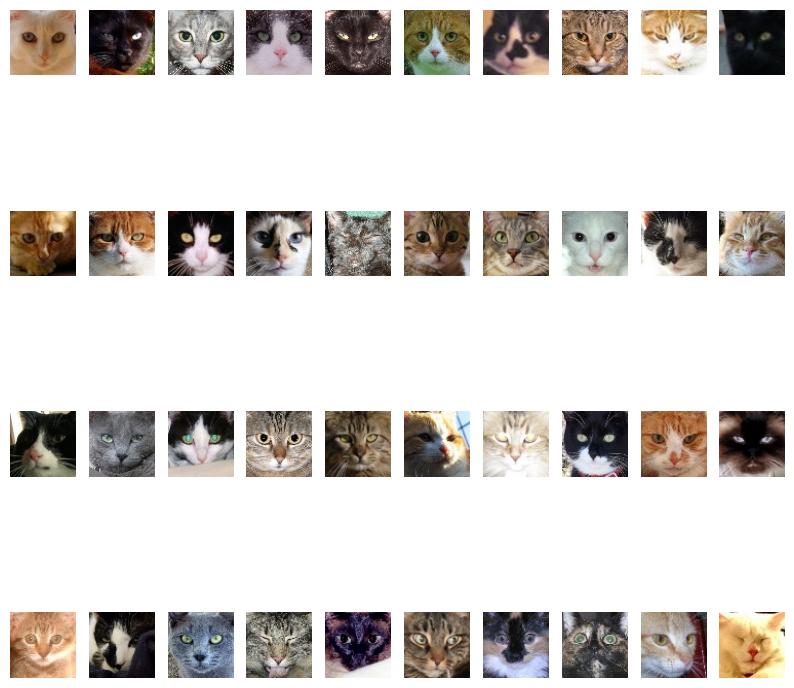

In [28]:
DrawTypical(reduced_cats, cats, predicted_classes[2], cluster_centers[2], 10);

Опишите отличительные черты кластеров:

первый кластер это более светлые котики, второй - котики с белым пятнышком на мордочке, третий - более тёмные котики.

Сильно ли они отличаются от предыдущего способа?

Всё ещё невозможно сделать выводы если взять ближайшие к центру элементы

#### 4. Нейросетевые эмбеддинги + кластеризация

Попробуем применить к изображениям такой же подход, как с текстами. То есть возьмем хорошую уже обученную нейросеть, получим с ее помощью эмбеддинги изображений и будем дулеть кластеризацию этих эмбеддингов.

Выберите на <a target="_blank" href="https://huggingface.co/models">huggingface</a> модель для получения эмбеддингов изображений.

**Примечания**
- Нам нужны `CV` модели для задачи извлечения признаков (в фильтрах huggingface называются `Image Feature Extraction`).
- Не выбирайте слишком тяжелые модели (с суффиксами `-huge`, `-giant`, `-large` и прочим), нам это ни к чему, так как картинки маленькие и простые. К тому же это замедлит предсказание эмбеддингов.
- Обычно в карточке модели есть пример применения, который можно скопировать и как в семинаре в цикле применить ко всем батчам изображениям.
- Некоторые модели могут возвращать не эмбеддинг размерности `(D,)`, а матрицу признаков размерности `(n, D)`, в этому случае надо применить average-pooling, усреднив по предпоследней оси.

Загрузите модель, примените к одному тестовому изображению кота и посмотрите на размерность полученного тензора

In [29]:
from transformers import AutoFeatureExtractor, ViTMSNModel
import torch
from PIL import Image
import requests
import os
from torch import nn

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(torch.cuda.is_available())

True


In [30]:
def GetEmbedding(feature_extractor, model, image, device):
  inputs = feature_extractor(images=image, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  last_hidden_states = outputs.last_hidden_state.squeeze().mean(axis=0);
  return last_hidden_states;

In [31]:
directory = os.fsencode("/content/cats")

for file in os.listdir(directory):
    filename = os.fsdecode(file)

image = Image.open("/content/cats/"+filename)

feature_extractor = AutoFeatureExtractor.from_pretrained("facebook/vit-msn-small")
model = ViTMSNModel.from_pretrained("facebook/vit-msn-small")
model.to(device)

GetEmbedding(feature_extractor, model, image, device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning:


The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning:

The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.



tensor([ 3.7629e-01,  1.7780e-01,  1.1002e-02,  7.1936e-01,  5.8362e-01,
        -6.1538e-02, -5.2842e-01,  8.8572e-01,  8.8020e-01, -4.4764e-01,
        -1.7049e-01, -1.1158e-01, -1.3890e+00,  1.2901e+00, -1.3366e-01,
         2.8716e-01, -1.1587e+00, -1.0656e-01, -1.2268e-01,  3.4365e-01,
        -5.5264e-01, -8.2510e-01, -7.2623e-02, -1.0012e+00,  8.5104e-01,
         1.2334e+00,  4.0865e-01, -1.2952e-01, -9.9257e-01,  8.8633e-01,
         5.4487e-01,  8.4423e-01, -5.3679e-01, -5.7447e-01,  1.2413e-01,
         6.5999e-01, -2.1640e-01,  3.9992e-01,  4.7517e-01, -1.2118e-01,
        -1.0147e+00, -9.9144e-01,  1.1749e+00,  9.5988e-02, -2.9849e-01,
         6.6976e-01, -1.0613e+00, -4.7251e-01,  8.1246e-01,  1.1130e+00,
         1.0746e+00, -9.6084e-02,  2.0816e-01,  1.2915e-01,  2.4849e-01,
         2.5612e-01,  1.3363e-01, -1.5062e-01,  7.5837e-01,  9.9008e-01,
         9.0697e-01,  5.1897e-01, -9.4761e-01, -2.6508e-01,  5.8166e-01,
        -2.8821e-01, -2.8048e+00, -8.9017e-01,  1.1

Теперь примените загруженную модель ко всем картинкам

In [32]:
embeddings = [];

count = 0;
for file in os.listdir(directory):
    filename = os.fsdecode(file)
    image = Image.open("/content/cats/"+filename)
    emb = GetEmbedding(feature_extractor, model, image, device);
    embeddings.append(np.array(emb.cpu()))
    print(count)
    count += 1;

Выходные данные были обрезаны до нескольких последних строк (5000).
10747
10748
10749
10750
10751
10752
10753
10754
10755
10756
10757
10758
10759
10760
10761
10762
10763
10764
10765
10766
10767
10768
10769
10770
10771
10772
10773
10774
10775
10776
10777
10778
10779
10780
10781
10782
10783
10784
10785
10786
10787
10788
10789
10790
10791
10792
10793
10794
10795
10796
10797
10798
10799
10800
10801
10802
10803
10804
10805
10806
10807
10808
10809
10810
10811
10812
10813
10814
10815
10816
10817
10818
10819
10820
10821
10822
10823
10824
10825
10826
10827
10828
10829
10830
10831
10832
10833
10834
10835
10836
10837
10838
10839
10840
10841
10842
10843
10844
10845
10846
10847
10848
10849
10850
10851
10852
10853
10854
10855
10856
10857
10858
10859
10860
10861
10862
10863
10864
10865
10866
10867
10868
10869
10870
10871
10872
10873
10874
10875
10876
10877
10878
10879
10880
10881
10882
10883
10884
10885
10886
10887
10888
10889
10890
10891
10892
10893
10894
10895
10896
10897
10898
10899
10900
10901
10

Сделайте кластеризацию полученных эмбеддингов

In [33]:
number_of_clusters = [2, 3, 4, 5, 6, 10]
variances = []
predicted_classes = []
cluster_centers = []

TestKmeans(embeddings, number_of_clusters, predicted_classes, cluster_centers, variances)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

<ipython-input-15-1bc9a036c35b>:26: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this o

Визуализируйте полученные кластера:

In [34]:
pca = PCA(n_components=2);
projection = pca.fit_transform(embeddings);

configure_plotly_browser_state()
visualize_images_clusterisation(cats, projection, predicted_classes[1], False)

Нарисуйте по 5-10 типичных изображений для новых кластеров

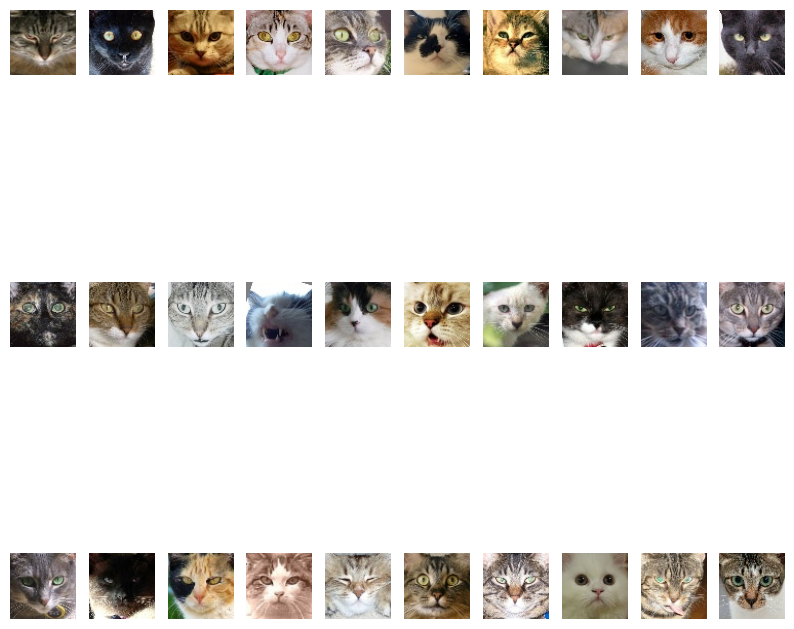

In [35]:
DrawTypical(np.array(embeddings), cats, predicted_classes[1], cluster_centers[1], 10);

Опишите отличительные черты кластеров:

***Ответ:***  
В новом подходе кластеры уже не связаны с цветами. Эмбеддинги, полученные с помощью нейронных сетей, обнаруживают другие закономерности, которые сложно заметить невооружённым глазом. Вместо того, чтобы отражать простые признаки, такие как цвет, эти кластеры, вероятно, выделяют более сложные характеристики, которые могут быть связаны с текстурой, формой или другими аспектами изображения.

Чем отличаются кластеры, полученные этим способом от первых двух?

***Ответ:***  
При использовании этого нового подхода кластеры могут иметь отличные от цветов характеристики. Это может означать, что кластеры разделяют изображения на основе более сложных признаков, таких как структура объектов, их контекст или другие визуальные атрибуты, которые могут быть неочевидными при первоначальном взгляде. Таким образом, кластеры, полученные этим способом, могут быть более информативными и могут обнаруживать более глубокие зависимости в данных.

#### 5. Выводы
Сделайте выводы:

Самыми эффективными способами кластеризации(из рассмотренных) оказались PCA + Kmeans и Embedding + Kmeans. Способ с просто kmeans фейлится из-за проклятия размерности, непохожие объекты начинают иметь похожие евклидовы расстояния, а т.к в первом случае не использовалось понижение размерности, то это стало критично. PCA помогает с этой проблемой выбрасывая ненужные координаты. Самый хороший способ - нейросетевые эмбеддинги, но в нашем случае он увидел какую-то неинтерпретируемую закономерность в фотографиях котиков, чтобы такого не было нужно дообучать feature extractor'ы именно на котиках